# Environment Set-up

In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import cv2
from utils.person_segmentation import yolo_detection, quick_mask, fine_mask
from utils.misc import to_PIL_image, to_PIL_mask, to_masked_image

In [2]:
from ultralytics import YOLO
from segment_anything import SamPredictor, sam_model_registry
from diffusers import StableDiffusionInpaintPipeline
from transformers import pipeline

C:\Users\admin\.conda\envs\pytorch\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Model Instantiation

In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [4]:
yolov8_model = YOLO('./model_ckpt/yolov8x.pt') # YOLOv8 instantiation

In [5]:
model_type = "vit_h"
sam_checkpoint = "./model_ckpt/sam_vit_h_4b8939.pth"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)
sam_model = SamPredictor(sam) # SAM predictor instantiation

In [6]:
caption_model = pipeline("image-to-text",model="ydshieh/vit-gpt2-coco-en")

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration.
C:\Users\admin\.conda\envs\pytorch\lib\site-packages\transformers\models\vit\feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [7]:
inpaint_model = StableDiffusionInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    revision="fp16",
    torch_dtype=torch.float16
).to(device) # Stable Diffusion pipeline instantiation

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
C:\Users\admin\.conda\envs\pytorch\lib\site-packages\transformers\models\clip\feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


# Person Romoval


0: 608x640 1 person, 1 handbag, 153.6ms
Speed: 5.9ms preprocess, 153.6ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)
C:\Users\admin\.conda\envs\pytorch\lib\site-packages\transformers\generation\utils.py:1288: UserWarning: Using `max_length`'s default (20) to control the generation length. This behaviour is deprecated and will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(
100%|██████████| 50/50 [00:03<00:00, 14.66it/s]


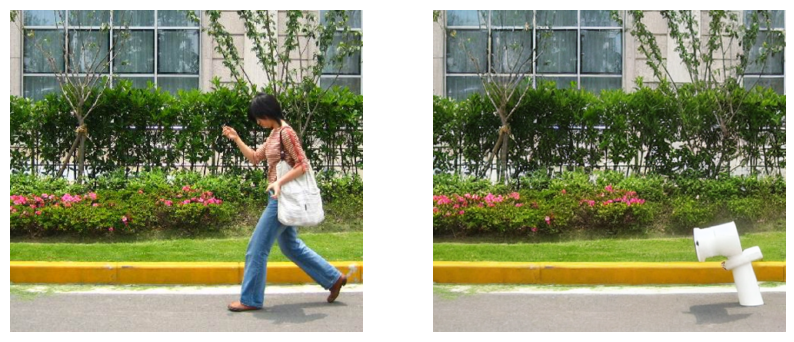


0: 544x640 2 persons, 1 handbag, 192.5ms
Speed: 3.0ms preprocess, 192.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.63it/s]


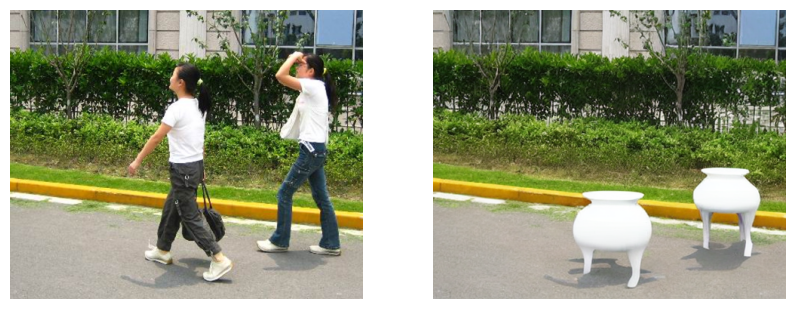


0: 512x640 2 persons, 191.0ms
Speed: 2.0ms preprocess, 191.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.70it/s]


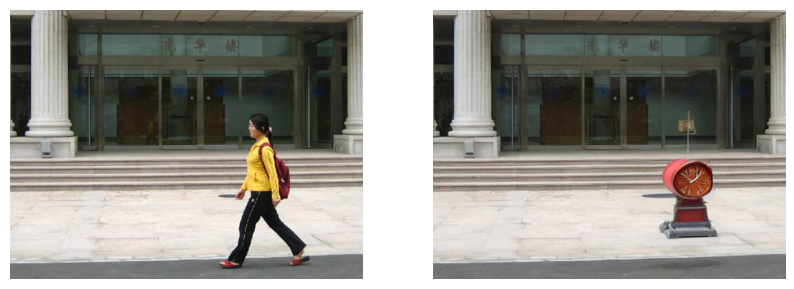


0: 544x640 2 persons, 24.9ms
Speed: 3.0ms preprocess, 24.9ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.21it/s]


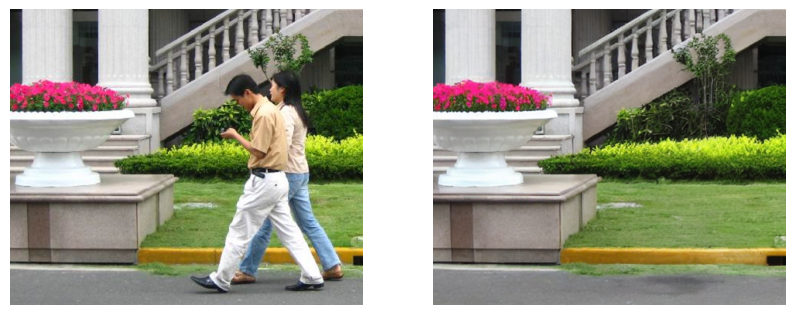


0: 640x640 7 persons, 1 handbag, 20.9ms
Speed: 4.0ms preprocess, 20.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.50it/s]


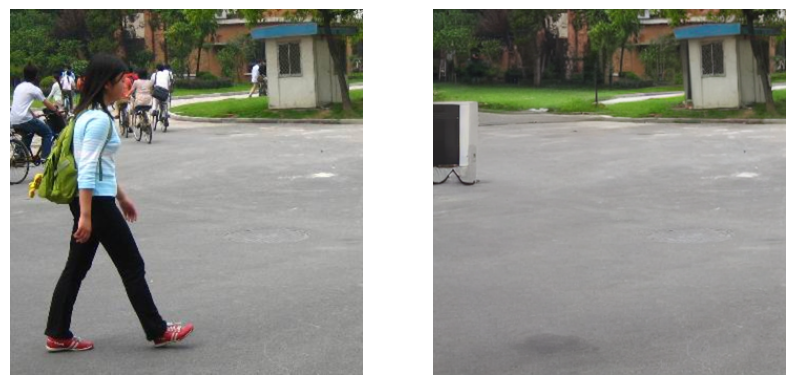


0: 512x640 10 persons, 1 handbag, 21.9ms
Speed: 3.0ms preprocess, 21.9ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.97it/s]


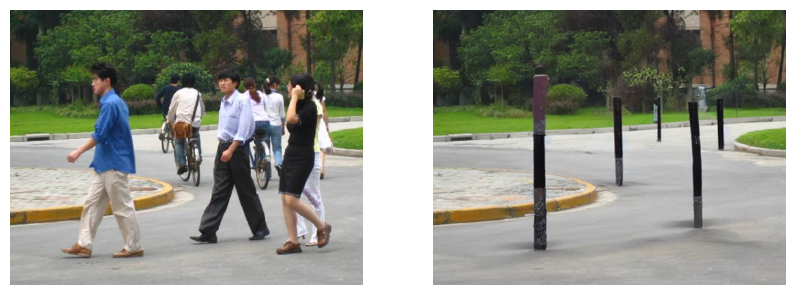


0: 640x512 4 persons, 148.7ms
Speed: 2.5ms preprocess, 148.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.38it/s]


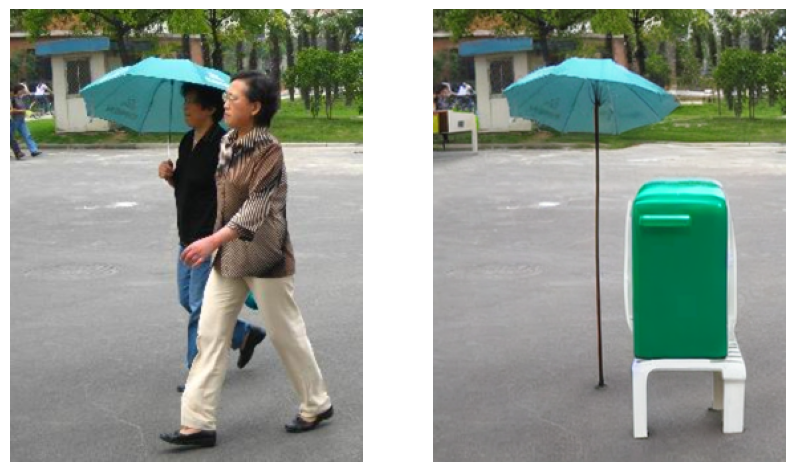


0: 640x512 1 person, 18.9ms
Speed: 2.0ms preprocess, 18.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.56it/s]


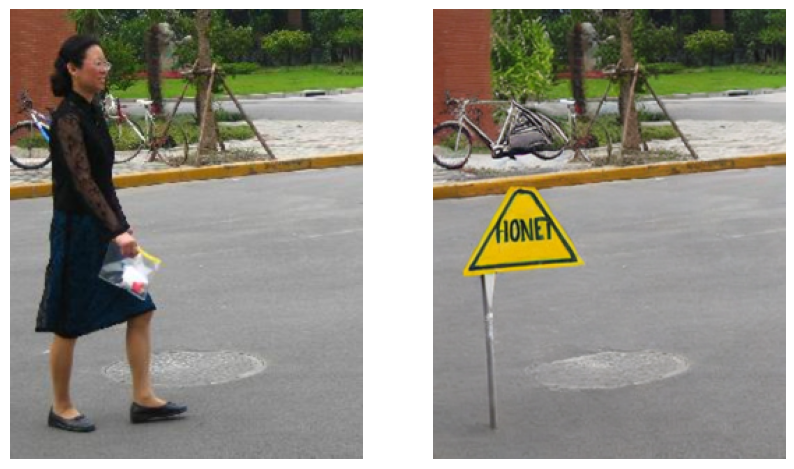


0: 576x640 2 persons, 2 handbags, 182.9ms
Speed: 4.0ms preprocess, 182.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.90it/s]


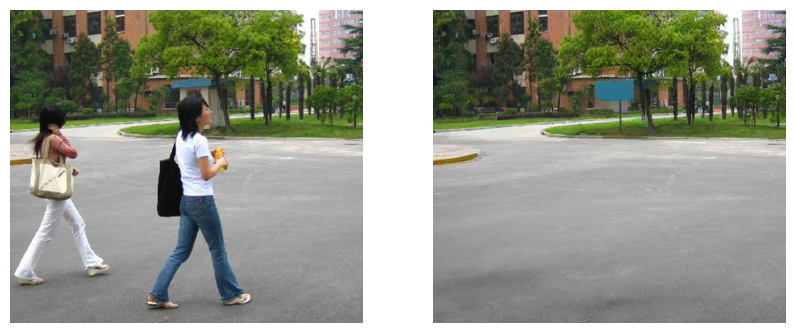


0: 512x640 1 person, 1 handbag, 20.9ms
Speed: 2.0ms preprocess, 20.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.88it/s]


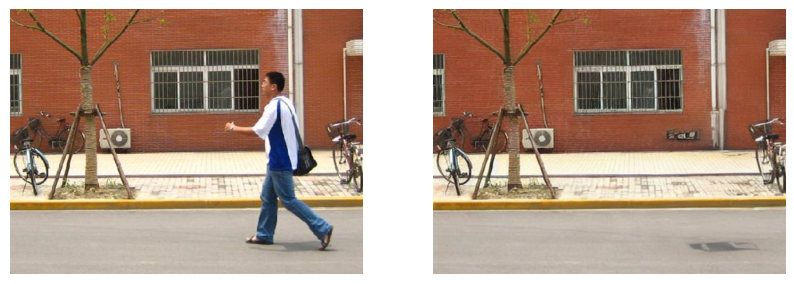


0: 512x640 5 persons, 20.9ms
Speed: 3.0ms preprocess, 20.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 14.95it/s]


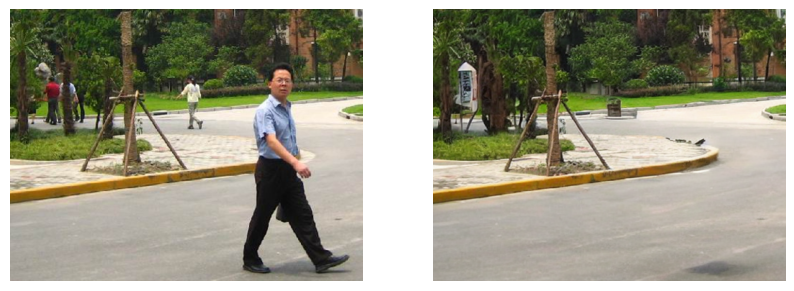


0: 576x640 4 persons, 3 handbags, 24.9ms
Speed: 4.0ms preprocess, 24.9ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 14.50it/s]


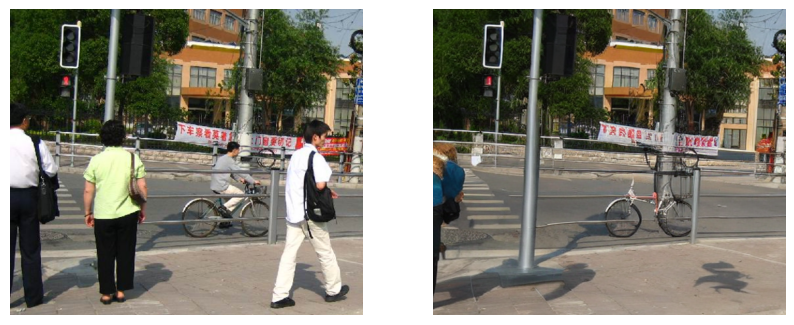


0: 640x640 3 persons, 23.5ms
Speed: 3.0ms preprocess, 23.5ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 12.87it/s]


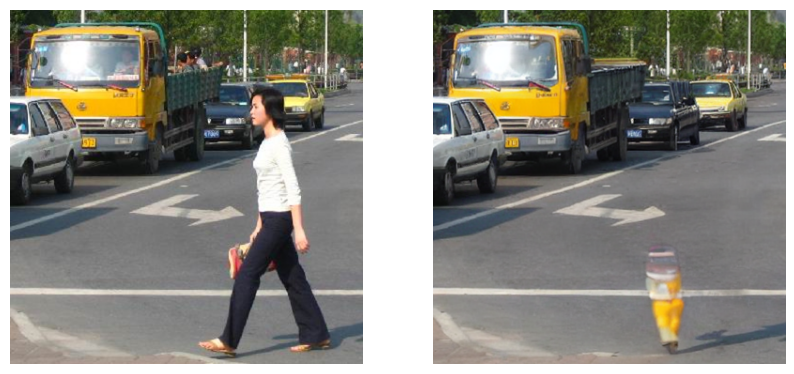


0: 512x640 1 person, 19.9ms
Speed: 2.0ms preprocess, 19.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.25it/s]


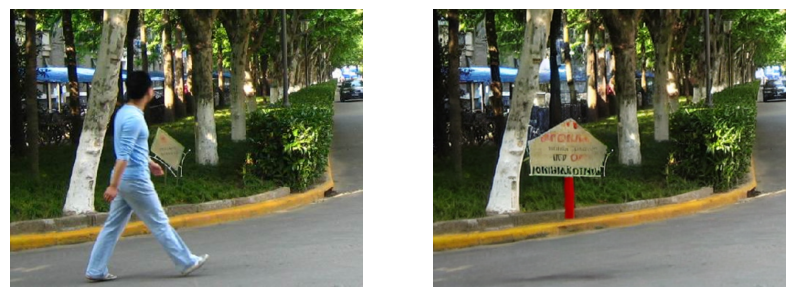


0: 576x640 7 persons, 5 handbags, 23.9ms
Speed: 3.0ms preprocess, 23.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.41it/s]


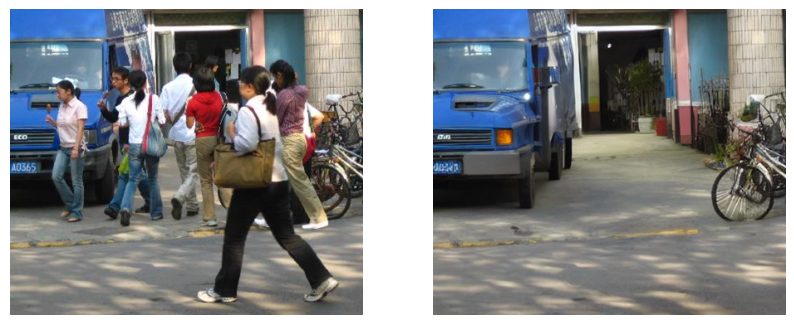


0: 640x640 2 persons, 31.9ms
Speed: 5.0ms preprocess, 31.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.20it/s]


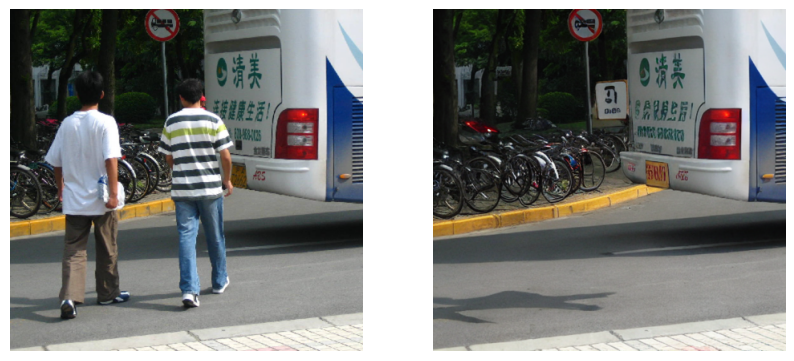


0: 640x544 2 persons, 171.5ms
Speed: 3.0ms preprocess, 171.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.40it/s]


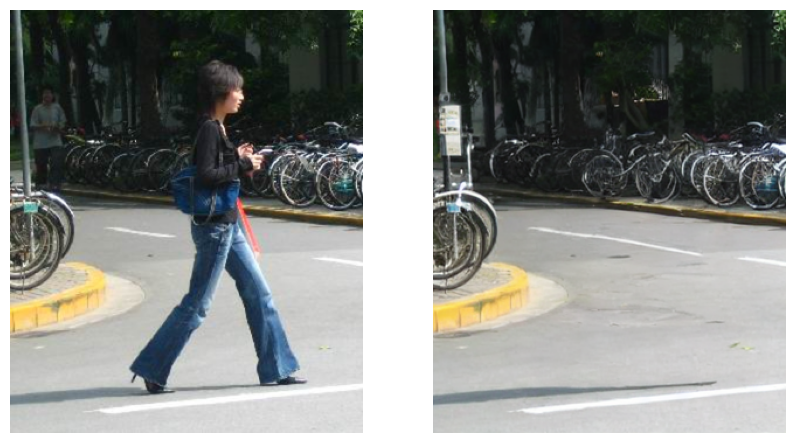


0: 640x608 3 persons, 147.6ms
Speed: 3.0ms preprocess, 147.6ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.76it/s]


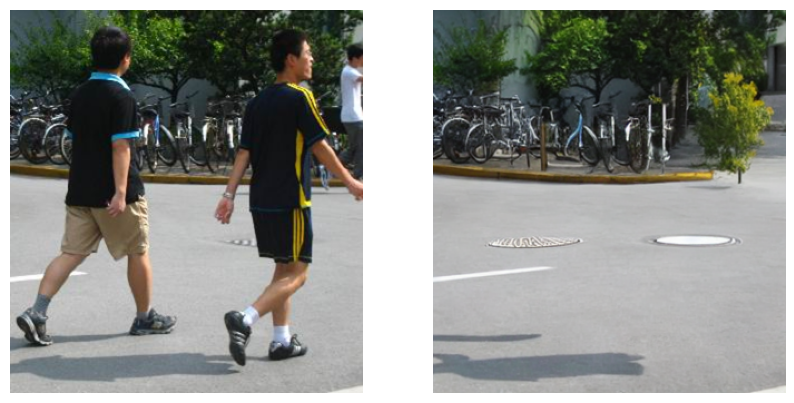


0: 608x640 3 persons, 24.9ms
Speed: 4.0ms preprocess, 24.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.01it/s]


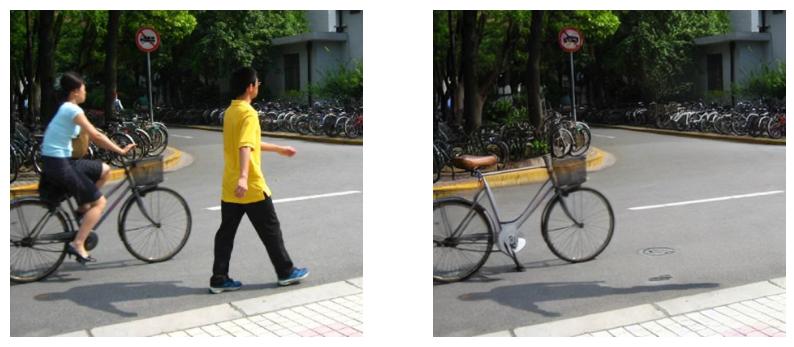


0: 544x640 1 person, 26.1ms
Speed: 3.0ms preprocess, 26.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.52it/s]


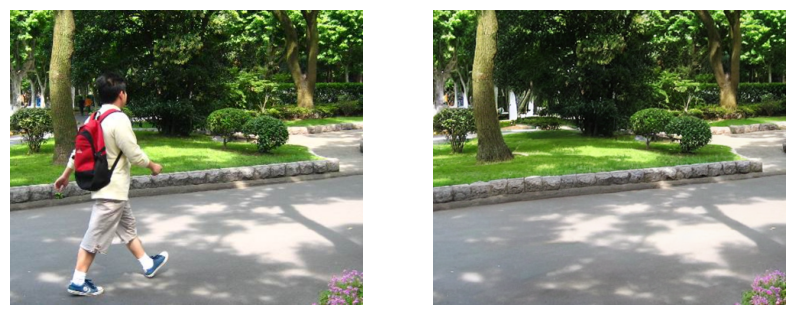


0: 512x640 3 persons, 20.9ms
Speed: 2.0ms preprocess, 20.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.64it/s]


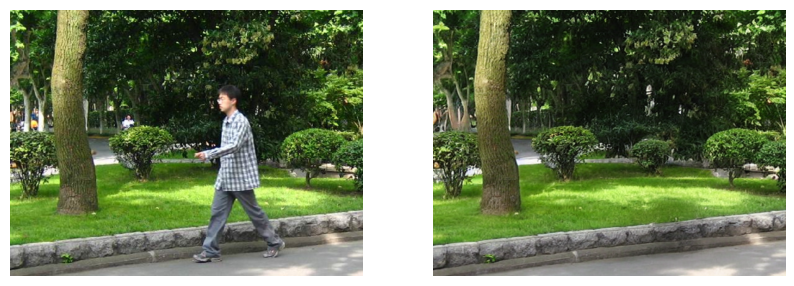


0: 512x640 1 person, 1 handbag, 19.9ms
Speed: 2.0ms preprocess, 19.9ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 14.79it/s]


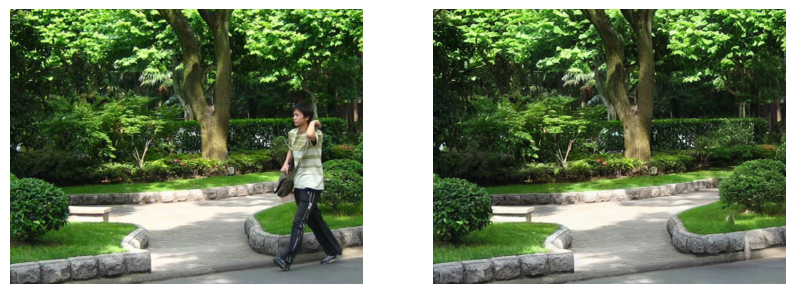


0: 608x640 2 persons, 23.9ms
Speed: 4.0ms preprocess, 23.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.23it/s]


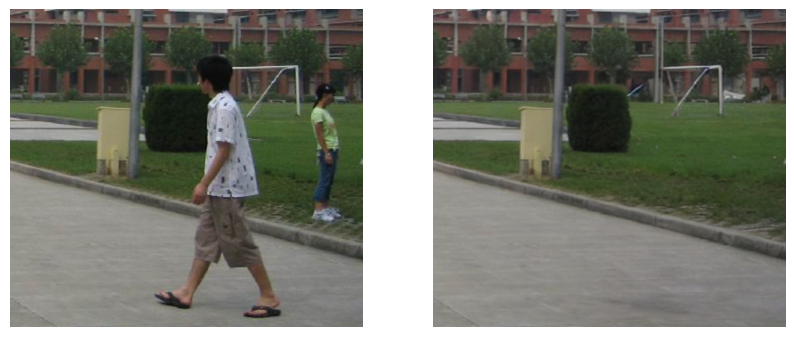


0: 640x576 5 persons, 152.6ms
Speed: 4.0ms preprocess, 152.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.49it/s]


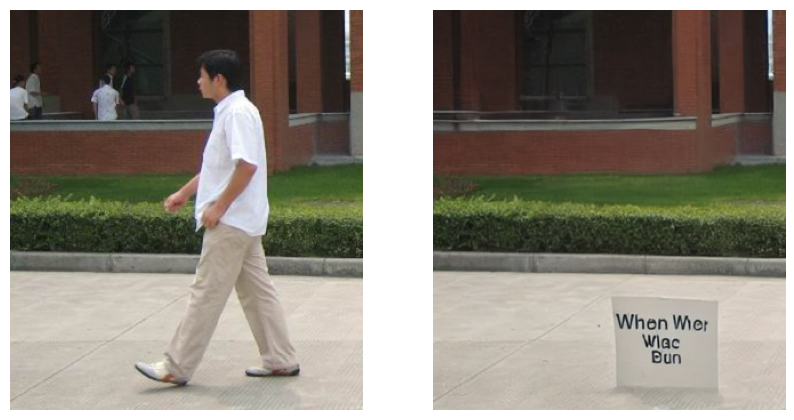


0: 640x544 2 persons, 21.9ms
Speed: 3.0ms preprocess, 21.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.15it/s]


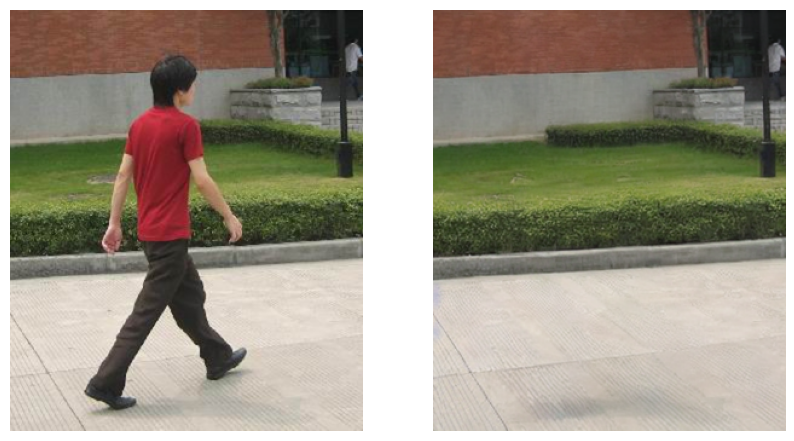


0: 288x640 5 persons, 1 handbag, 188.6ms
Speed: 2.0ms preprocess, 188.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.32it/s]


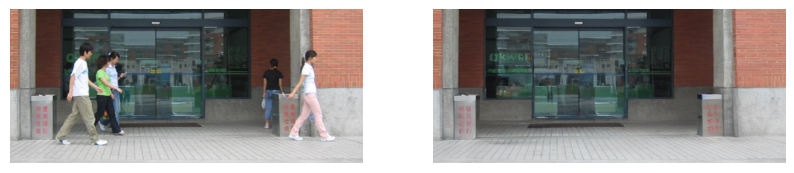


0: 576x640 5 persons, 1 handbag, 23.9ms
Speed: 3.0ms preprocess, 23.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.32it/s]


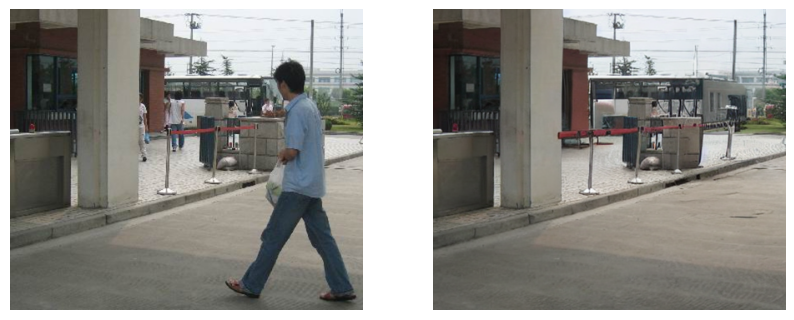


0: 544x640 2 persons, 1 handbag, 21.9ms
Speed: 3.0ms preprocess, 21.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.49it/s]


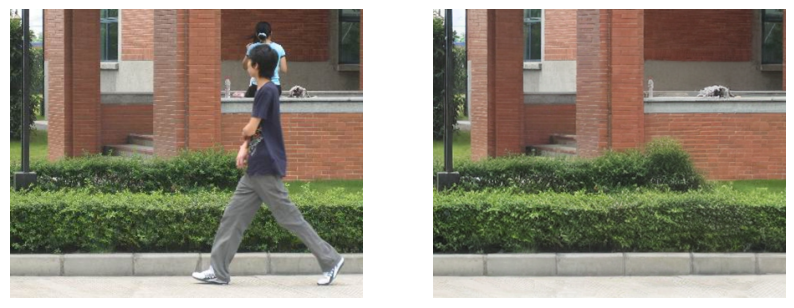


0: 640x640 2 persons, 21.9ms
Speed: 4.0ms preprocess, 21.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.61it/s]


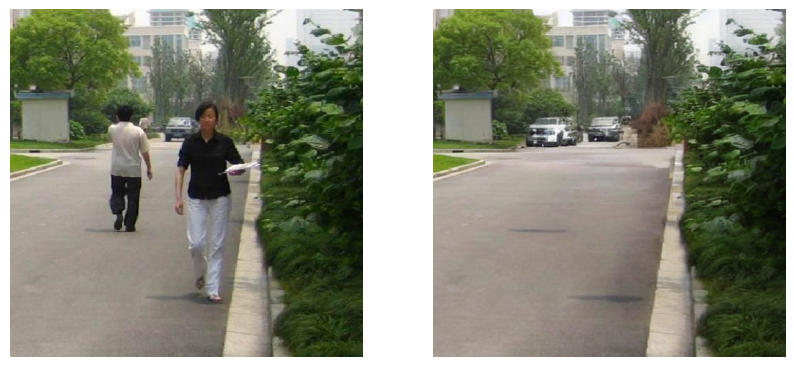


0: 576x640 3 persons, 25.0ms
Speed: 3.0ms preprocess, 25.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.29it/s]


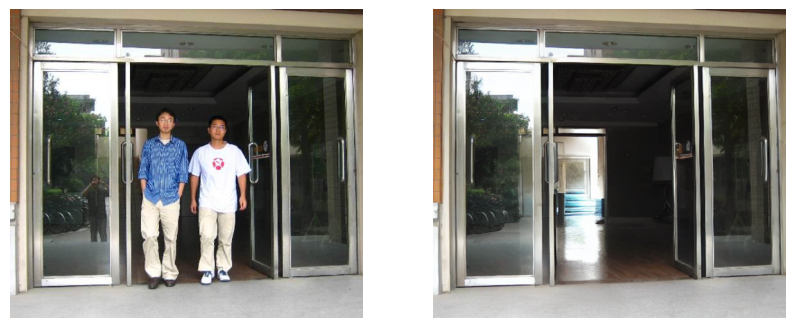


0: 608x640 8 persons, 2 handbags, 23.9ms
Speed: 3.0ms preprocess, 23.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 14.75it/s]


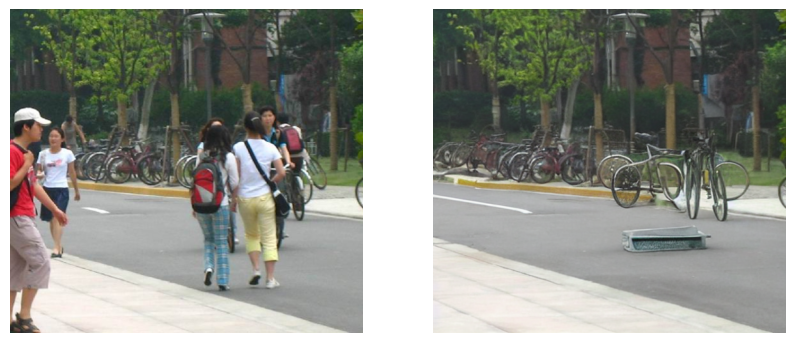


0: 608x640 6 persons, 22.9ms
Speed: 3.0ms preprocess, 22.9ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.13it/s]


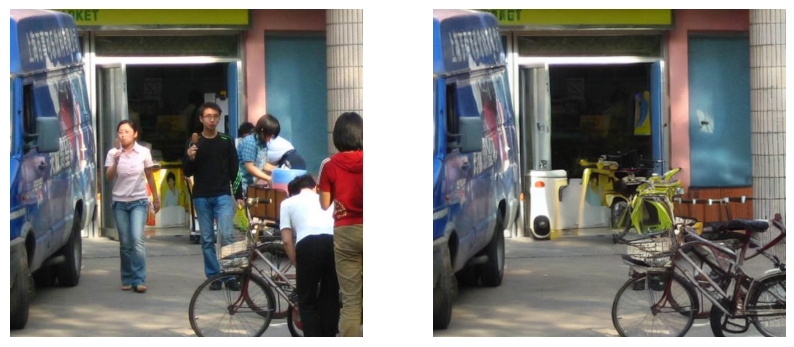


0: 640x640 8 persons, 3 handbags, 22.9ms
Speed: 3.0ms preprocess, 22.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.24it/s]


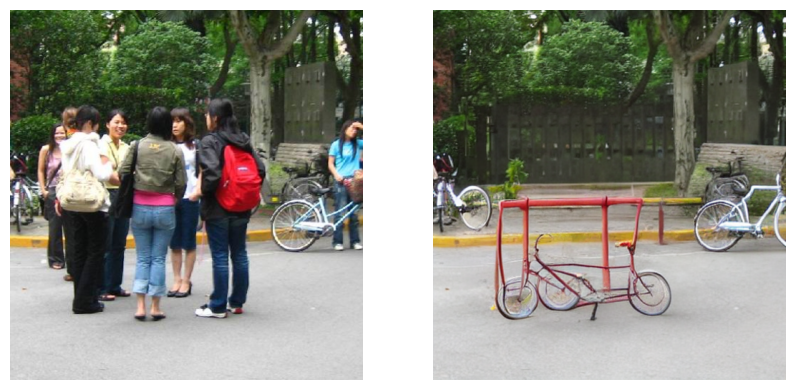


0: 608x640 12 persons, 2 handbags, 24.9ms
Speed: 5.0ms preprocess, 24.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 14.35it/s]


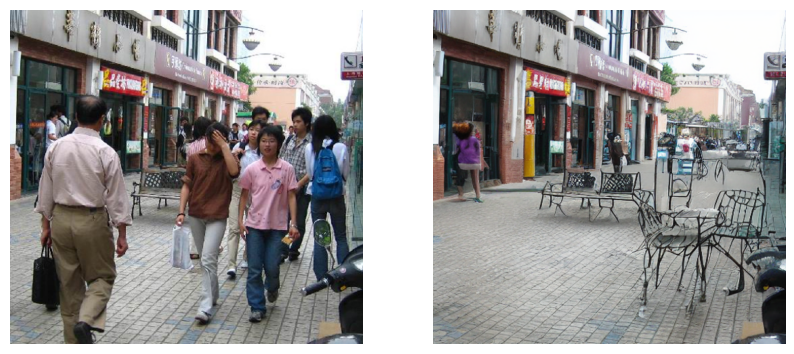


0: 640x608 9 persons, 4 handbags, 24.9ms
Speed: 3.0ms preprocess, 24.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.35it/s]


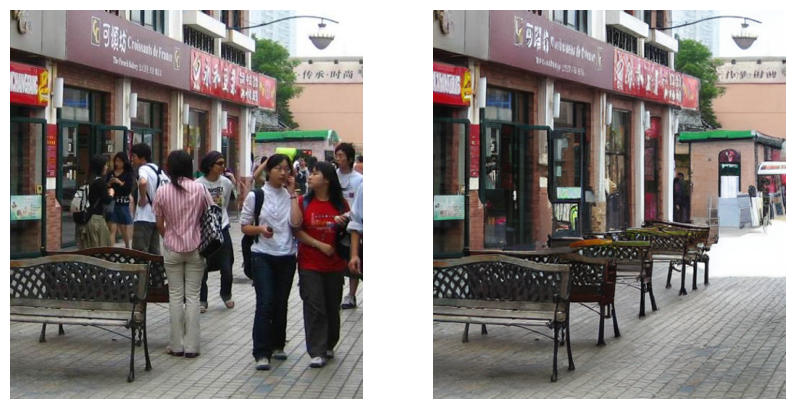


0: 512x640 10 persons, 1 handbag, 21.9ms
Speed: 2.0ms preprocess, 21.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.25it/s]


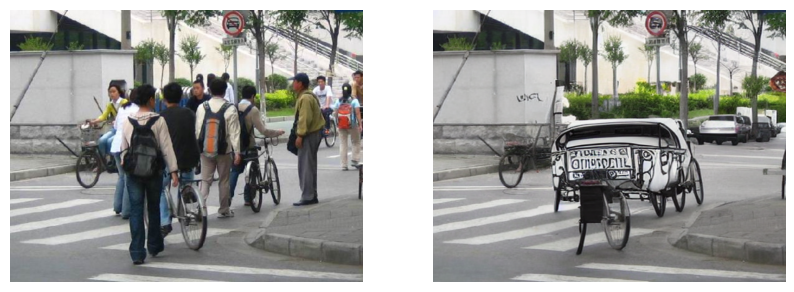


0: 640x608 11 persons, 24.6ms
Speed: 4.0ms preprocess, 24.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.36it/s]


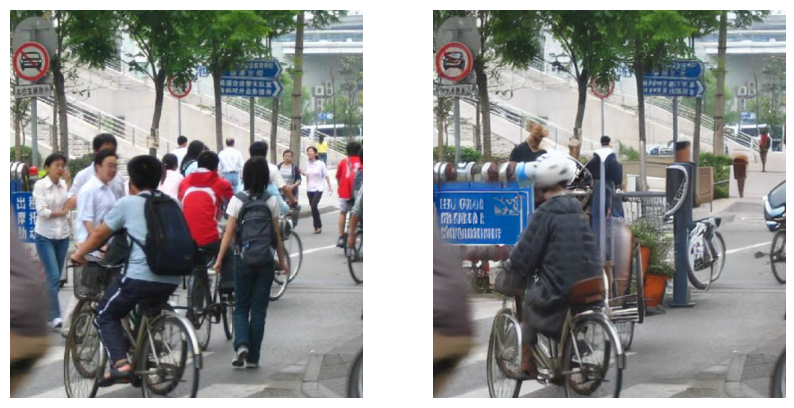


0: 640x640 13 persons, 2 handbags, 38.9ms
Speed: 4.0ms preprocess, 38.9ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.60it/s]


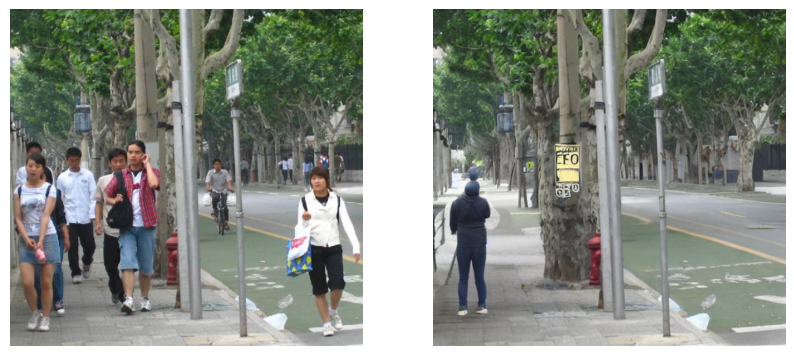


0: 640x576 7 persons, 31.1ms
Speed: 4.2ms preprocess, 31.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.34it/s]


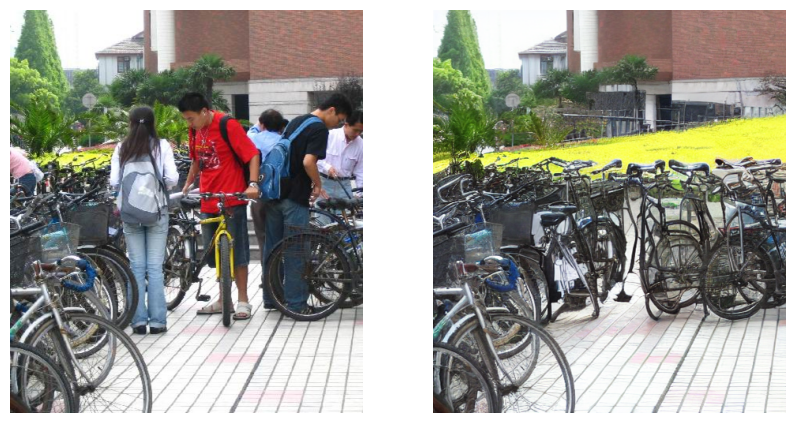


0: 576x640 2 persons, 23.3ms
Speed: 3.0ms preprocess, 23.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)
100%|██████████| 50/50 [00:03<00:00, 15.47it/s]


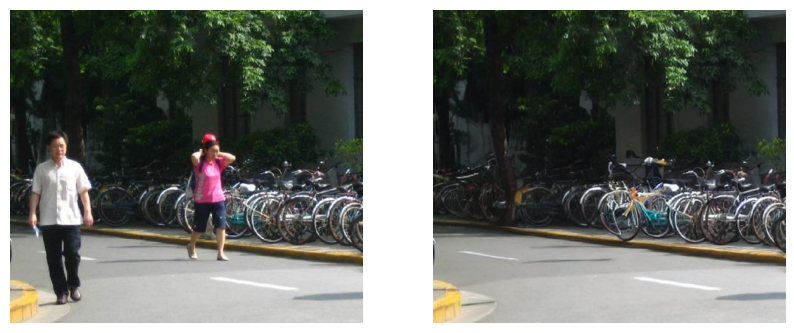

In [8]:
for i in range(10,50):
    image_path = 'PennFudanPed/PNGImages/FudanPed'+str(i+1).zfill(5)+'.png'
    image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
    # detection
    person_boxes = yolo_detection(yolov8_model, image)
    q_mask = quick_mask(image, person_boxes)
    f_mask = fine_mask(sam_model, image, person_boxes)
    # transform image to PIL
    image_PIL, original_size = to_PIL_image(image)
    # transform mask to PIL
    mask_PIL = to_PIL_mask(image, f_mask)
    # create masked image
    masked_image = to_masked_image(image, person_boxes)
    # caption (masked_image_PIL)
    caption = caption_model(masked_image)[0]['generated_text']
    # inpainting (image_PIL, mask_PIL)
    inpainted_image = inpaint_model(prompt="background of "+caption, image=image_PIL, mask_image=mask_PIL).images[0]
    # show images
    plt.figure(figsize=(10,6))
    plt.subplot(1, 2, 1)
    plt.imshow(image_PIL.resize(original_size))
    plt.axis("off")
    plt.subplot(1, 2, 2)
    plt.imshow(inpainted_image.resize(original_size))
    plt.axis("off")
    plt.show()